## Setup

In [ ]:
#Importanto todas bibliotecas
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import statistics as stt
import seaborn as sns
from typing import List, Union, Optional
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn import metrics
from prettytable import PrettyTable

In [ ]:
#Linkando o Google Drive e dizendo onde ficará salvo no projeto
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Caminho do database
path = '/content/drive/MyDrive/Pregnancy During the COVID-19 Pandemic.csv'

#Usando pandas para armazenar o dataset na variavel
database = pd.read_csv(path)

#Printando dataset
database

,OSF_ID,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,PROMIS_Anxiety,Gestational_Age_At_Birth,Delivery_Date(converted to month and year),Birth_Length,Birth_Weight,Delivery_Mode,NICU_Stay,Language,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm
0,1,38.3,"$200,000+",Masters degree,9.0,13.0,39.71,Dec2020,49.20,3431.0,Vaginally,No,English,2,3,27
1,2,34.6,"$200,000+",Undergraduate degree,4.0,17.0,NaN,NaN,NaN,NaN,NaN,NaN,English,2,33,92
2,3,34.3,"$100,000 -$124,999",Undergraduate degree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,French,,,
3,4,28.8,"$100,000 -$124,999",Masters degree,9.0,20.0,38.57,Dec2020,41.00,2534.0,Vaginally,No,French,53,67,54
4,5,36.5,"$40,000-$69,999",Undergraduate degree,14.0,20.0,39.86,Oct2020,53.34,3714.0,Caesarean-section (c-section),No,English,23,32,71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10767,10768,38.3,"$100,000 -$124,999",Undergraduate degree,10.0,18.0,NaN,NaN,NaN,NaN,NaN,NaN,English,54,62,74
10768,10769,29.9,"$125,000- $149,999",Undergraduate degree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,English,,,
10769,10770,27.7,"$20,000- $39,999",College/trade school,4.0,15.0,NaN,NaN,NaN,NaN,NaN,NaN,French,21,93,76
10770,10771,23.0,"$20,000- $39,999",College/trade school,12.0,19.0,NaN,NaN,NaN,NaN,NaN,NaN,English,65,94,94


## Pré-Processamento

In [ ]:
#Printando dataset bruto
database

,OSF_ID,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,PROMIS_Anxiety,Gestational_Age_At_Birth,Delivery_Date(converted to month and year),Birth_Length,Birth_Weight,Delivery_Mode,NICU_Stay,Language,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm
0,1,38.3,"$200,000+",Masters degree,9.0,13.0,39.71,Dec2020,49.20,3431.0,Vaginally,No,English,2,3,27
1,2,34.6,"$200,000+",Undergraduate degree,4.0,17.0,NaN,NaN,NaN,NaN,NaN,NaN,English,2,33,92
2,3,34.3,"$100,000 -$124,999",Undergraduate degree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,French,,,
3,4,28.8,"$100,000 -$124,999",Masters degree,9.0,20.0,38.57,Dec2020,41.00,2534.0,Vaginally,No,French,53,67,54
4,5,36.5,"$40,000-$69,999",Undergraduate degree,14.0,20.0,39.86,Oct2020,53.34,3714.0,Caesarean-section (c-section),No,English,23,32,71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10767,10768,38.3,"$100,000 -$124,999",Undergraduate degree,10.0,18.0,NaN,NaN,NaN,NaN,NaN,NaN,English,54,62,74
10768,10769,29.9,"$125,000- $149,999",Undergraduate degree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,English,,,
10769,10770,27.7,"$20,000- $39,999",College/trade school,4.0,15.0,NaN,NaN,NaN,NaN,NaN,NaN,French,21,93,76
10770,10771,23.0,"$20,000- $39,999",College/trade school,12.0,19.0,NaN,NaN,NaN,NaN,NaN,NaN,English,65,94,94


In [ ]:
#Contagem de valores nulos
database.isnull().sum()

OSF_ID                                           0
Maternal_Age                                   111
Household_Income                               251
Maternal_Education                             177
Edinburgh_Postnatal_Depression_Scale          1174
PROMIS_Anxiety                                1206
Gestational_Age_At_Birth                      4038
Delivery_Date(converted to month and year)    4039
Birth_Length                                  5292
Birth_Weight                                  4694
Delivery_Mode                                 5235
NICU_Stay                                     5238
Language                                         0
Threaten_Life                                    0
Threaten_Baby_Danger                             0
Threaten_Baby_Harm                               0
dtype: int64

In [ ]:
#Descrição do dataset
database.describe()

,OSF_ID,Maternal_Age,Edinburgh_Postnatal_Depression_Scale,PROMIS_Anxiety,Gestational_Age_At_Birth,Birth_Length,Birth_Weight
count,10772.000000,10661.000000,9598.000000,9566.000000,6734.000000,5480.000000,6078.000000
mean,5386.500000,31.844602,10.194832,18.677713,39.342241,50.502504,3412.175058
std,3109.752884,4.422368,5.505230,6.084313,1.612483,4.445347,538.695046
min,1.000000,17.000000,0.000000,7.000000,24.860000,20.000000,303.000000
25%,2693.750000,28.900000,6.000000,14.000000,38.570000,49.000000,3102.250000
50%,5386.500000,31.800000,10.000000,19.000000,39.570000,50.800000,3431.000000
75%,8079.250000,34.800000,14.000000,23.000000,40.430000,53.030000,3742.000000
max,10772.000000,49.700000,30.000000,35.000000,42.860000,70.000000,5968.000000


<ipython-input-7-07a0a9f934dc>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.countplot(data=df_category, x=column , palette='pastel')


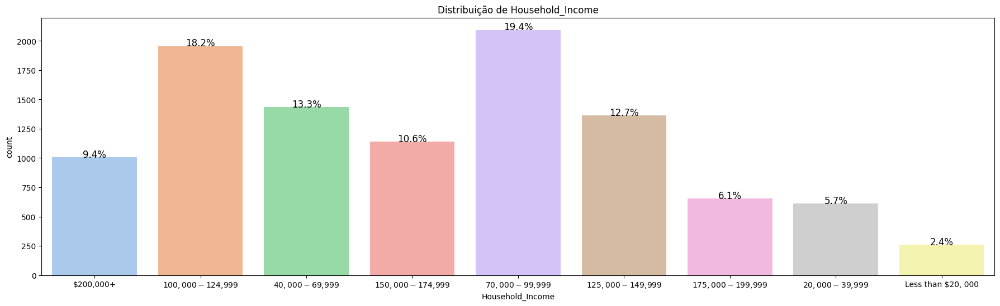

<ipython-input-7-07a0a9f934dc>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.countplot(data=df_category, x=column , palette='pastel')


<Figure size 800x600 with 0 Axes>

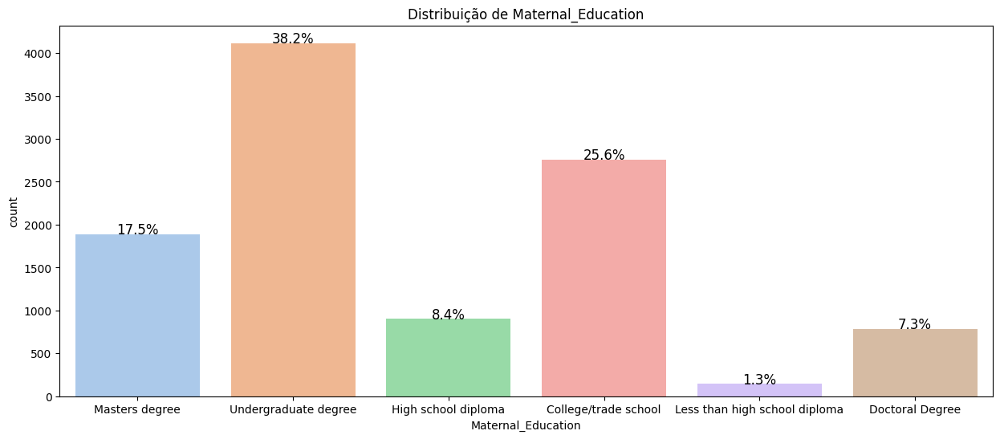

<ipython-input-7-07a0a9f934dc>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.countplot(data=df_category, x=column , palette='pastel')


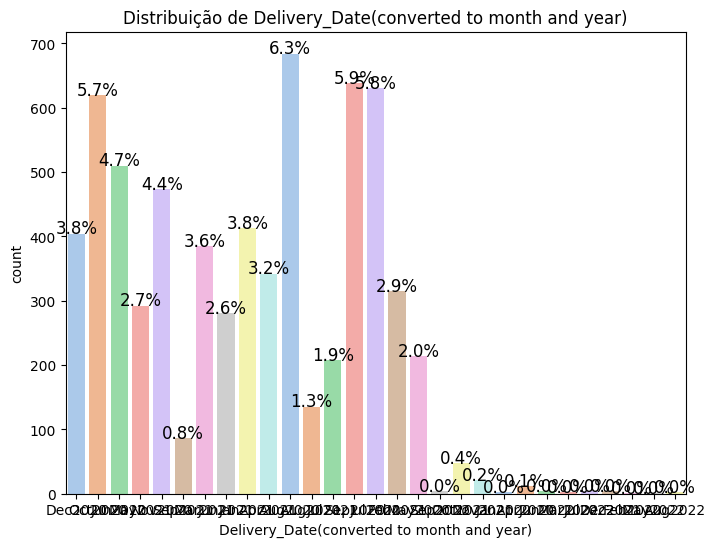

<ipython-input-7-07a0a9f934dc>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.countplot(data=df_category, x=column , palette='pastel')


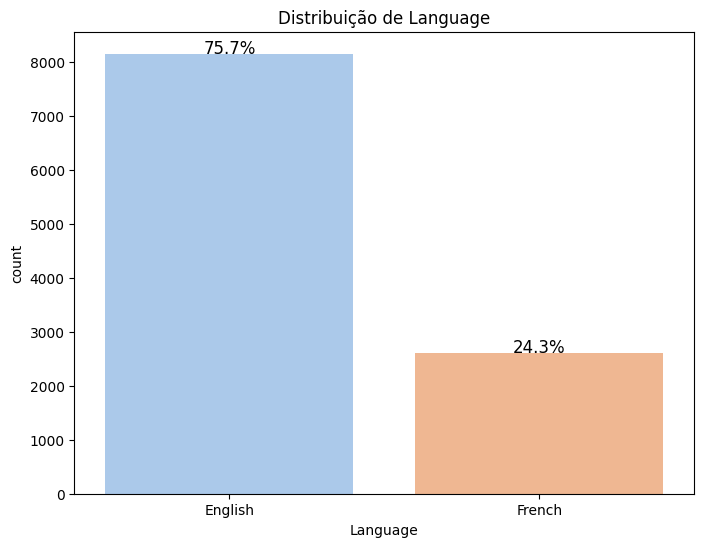

<ipython-input-7-07a0a9f934dc>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.countplot(data=df_category, x=column , palette='pastel')


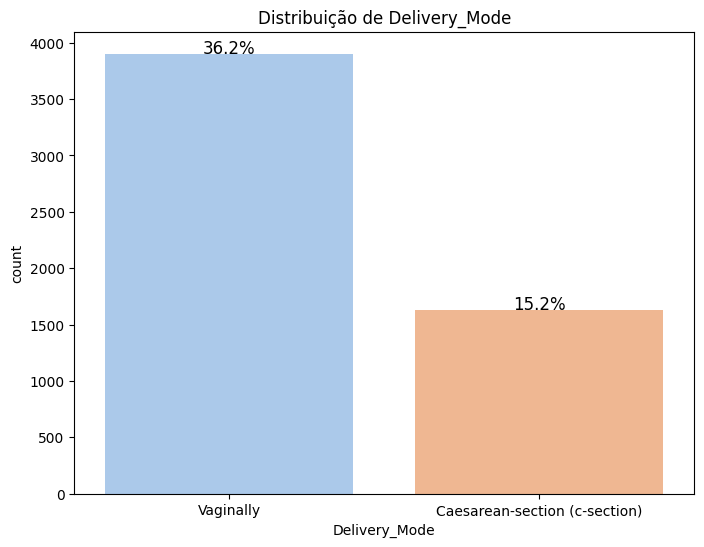

<ipython-input-7-07a0a9f934dc>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.countplot(data=df_category, x=column , palette='pastel')


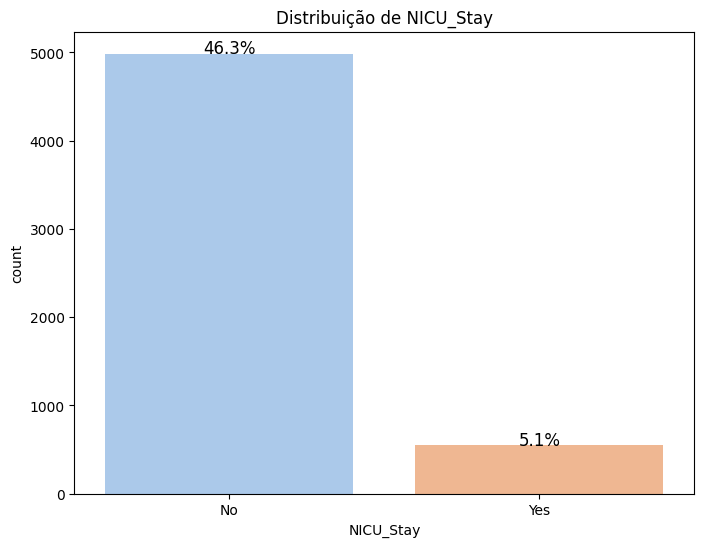

In [ ]:
#Selecionando as colunas Categóricas
df_category = database[['Household_Income', 'Maternal_Education', 'Delivery_Date(converted to month and year)', 'Language', 'Delivery_Mode', 'NICU_Stay', 'OSF_ID']]

#Tirando a coluna de ID da seleção
column_categ = df_category.columns[:-1]

#Laço para plotar gráficos referentes às colunas categoricas
#importante observar algumas informações para realizar o resto do pré processamento
for column in column_categ:
    if column == 'Household_Income':
      plt.figure(figsize=(22, 6))
    else:
      plt.figure(figsize=(8, 6))

    if column == 'Maternal_Education':
      plt.figure(figsize=(15, 6))

    ax1 = sns.countplot(data=df_category, x=column , palette='pastel')
    plt.title(f'Distribuição de {column}')

    total = len(df_category[column])
    for p in ax1.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height() / total)
        ax1.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='baseline', fontsize=12, color='black')

    plt.show()

In [ ]:
#Tratamento de valores nulos
database.loc[database['Threaten_Life'] == ' ', ['Threaten_Life']] = 42
database.loc[database['Threaten_Baby_Danger'] == ' ', ['Threaten_Baby_Danger']] = 50
database.loc[database['Threaten_Baby_Harm'] == ' ', ['Threaten_Baby_Harm']] = 62

for x in range(101):
  database.loc[database['Threaten_Life'] == str(x), ['Threaten_Life']] = x
  database.loc[database['Threaten_Baby_Danger'] == str(x), ['Threaten_Baby_Danger']] = x
  database.loc[database['Threaten_Baby_Harm'] == str(x), ['Threaten_Baby_Harm']] = x

database = database.drop('OSF_ID',axis = 1)
database_completo = database.fillna({
    'Maternal_Age': database['Maternal_Age'].mean(),
    'Household_Income': 'Não informado',
    'Maternal_Education': 'Não informado',
    'Edinburgh_Postnatal_Depression_Scale': database['Edinburgh_Postnatal_Depression_Scale'].mean(),
    'PROMIS_Anxiety': database['PROMIS_Anxiety'].mean(),
    'Delivery_Date(converted to month and year)': 'Não informado',
    'Gestational_Age_At_Birth': database['Gestational_Age_At_Birth'].mean(),
    'Birth_Length': database['Birth_Length'].mean(),
    'Birth_Weight' : database['Birth_Weight'].mean(),
    'Delivery_Mode' : 'Não informado',
    'NICU_Stay': 'Não informado'
})

#Criação de novo dataset removendo colunas onde mais de 10% das pessoas
#deixaram em branco no formulário referente ao dataset bruto
database_reduzido = database.fillna({
    'Maternal_Age': database['Maternal_Age'].mean(),
    'Household_Income': 'Não informado',
    'Maternal_Education': 'Não informado',
    'Edinburgh_Postnatal_Depression_Scale': database['Edinburgh_Postnatal_Depression_Scale'].mean()
})
database_reduzido = database_reduzido.drop('PROMIS_Anxiety', axis=1)
database_reduzido = database_reduzido.drop('Delivery_Date(converted to month and year)', axis=1)
database_reduzido = database_reduzido.drop('Gestational_Age_At_Birth', axis=1)
database_reduzido = database_reduzido.drop('Birth_Length', axis=1)
database_reduzido = database_reduzido.drop('Birth_Weight', axis=1)
database_reduzido = database_reduzido.drop('Delivery_Mode', axis=1)
database_reduzido = database_reduzido.drop('NICU_Stay', axis=1)

In [ ]:
#Referente ao Dataset Bruto
database_completo

,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,PROMIS_Anxiety,Gestational_Age_At_Birth,Delivery_Date(converted to month and year),Birth_Length,Birth_Weight,Delivery_Mode,NICU_Stay,Language,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm
0,38.3,"$200,000+",Masters degree,9.000000,13.000000,39.710000,Dec2020,49.200000,3431.000000,Vaginally,No,English,2,3,27
1,34.6,"$200,000+",Undergraduate degree,4.000000,17.000000,39.342241,Não informado,50.502504,3412.175058,Não informado,Não informado,English,2,33,92
2,34.3,"$100,000 -$124,999",Undergraduate degree,10.194832,18.677713,39.342241,Não informado,50.502504,3412.175058,Não informado,Não informado,French,42,50,62
3,28.8,"$100,000 -$124,999",Masters degree,9.000000,20.000000,38.570000,Dec2020,41.000000,2534.000000,Vaginally,No,French,53,67,54
4,36.5,"$40,000-$69,999",Undergraduate degree,14.000000,20.000000,39.860000,Oct2020,53.340000,3714.000000,Caesarean-section (c-section),No,English,23,32,71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10767,38.3,"$100,000 -$124,999",Undergraduate degree,10.000000,18.000000,39.342241,Não informado,50.502504,3412.175058,Não informado,Não informado,English,54,62,74
10768,29.9,"$125,000- $149,999",Undergraduate degree,10.194832,18.677713,39.342241,Não informado,50.502504,3412.175058,Não informado,Não informado,English,42,50,62
10769,27.7,"$20,000- $39,999",College/trade school,4.000000,15.000000,39.342241,Não informado,50.502504,3412.175058,Não informado,Não informado,French,21,93,76
10770,23.0,"$20,000- $39,999",College/trade school,12.000000,19.000000,39.342241,Não informado,50.502504,3412.175058,Não informado,Não informado,English,65,94,94


In [ ]:
#Referente ao Dataset Processado
database_reduzido

,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,Language,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm
0,38.3,"$200,000+",Masters degree,9.000000,English,2,3,27
1,34.6,"$200,000+",Undergraduate degree,4.000000,English,2,33,92
2,34.3,"$100,000 -$124,999",Undergraduate degree,10.194832,French,42,50,62
3,28.8,"$100,000 -$124,999",Masters degree,9.000000,French,53,67,54
4,36.5,"$40,000-$69,999",Undergraduate degree,14.000000,English,23,32,71
...,...,...,...,...,...,...,...,...
10767,38.3,"$100,000 -$124,999",Undergraduate degree,10.000000,English,54,62,74
10768,29.9,"$125,000- $149,999",Undergraduate degree,10.194832,English,42,50,62
10769,27.7,"$20,000- $39,999",College/trade school,4.000000,French,21,93,76
10770,23.0,"$20,000- $39,999",College/trade school,12.000000,English,65,94,94


In [ ]:
#Label Enconder e Normalização dos dados

label_encoder = LabelEncoder()
l = ['','','']
cont = 0
columns = ['Household_Income','Maternal_Education','Delivery_Date(converted to month and year)']

for col in columns:
    l[cont] = database_completo[col]
    database_completo[col] = label_encoder.fit_transform(database_completo[col])
    if col != 'Delivery_Date(converted to month and year)':
      database_reduzido[col] = label_encoder.fit_transform(database_reduzido[col])
    cont+=1

scaler = StandardScaler()

columns_to_normalize = ['Delivery_Date(converted to month and year)']

database_completo[columns_to_normalize] = scaler.fit_transform(database_completo[columns_to_normalize])
database_completo[columns_to_normalize] = database_completo[columns_to_normalize] - np.min(database_completo[columns_to_normalize])

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:86: FutureWarning: In a future version, DataFrame.min(axis=None) will return a scalar min over the entire DataFrame. To retain the old behavior, use 'frame.min(axis=0)' or just 'frame.min()'
  return reduction(axis=axis, out=out, **passkwargs)


In [ ]:
#Printando Dataset bruto após Label Encoder
database_completo

,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,PROMIS_Anxiety,Gestational_Age_At_Birth,Delivery_Date(converted to month and year),Birth_Length,Birth_Weight,Delivery_Mode,NICU_Stay,Language,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm
0,38.3,5,4,9.000000,13.000000,39.710000,0.600274,49.200000,3431.000000,Vaginally,No,English,2,3,27
1,34.6,5,6,4.000000,17.000000,39.342241,2.881317,50.502504,3412.175058,Não informado,Não informado,English,2,33,92
2,34.3,0,6,10.194832,18.677713,39.342241,2.881317,50.502504,3412.175058,Não informado,Não informado,French,42,50,62
3,28.8,0,4,9.000000,20.000000,38.570000,0.600274,41.000000,2534.000000,Vaginally,No,French,53,67,54
4,36.5,6,6,14.000000,20.000000,39.860000,3.001372,53.340000,3714.000000,Caesarean-section (c-section),No,English,23,32,71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10767,38.3,0,6,10.000000,18.000000,39.342241,2.881317,50.502504,3412.175058,Não informado,Não informado,English,54,62,74
10768,29.9,1,6,10.194832,18.677713,39.342241,2.881317,50.502504,3412.175058,Não informado,Não informado,English,42,50,62
10769,27.7,4,0,4.000000,15.000000,39.342241,2.881317,50.502504,3412.175058,Não informado,Não informado,French,21,93,76
10770,23.0,4,0,12.000000,19.000000,39.342241,2.881317,50.502504,3412.175058,Não informado,Não informado,English,65,94,94


In [ ]:
#Pegando colunas categoricas para usar o One Hot Encoder
categorical_columns = ['Delivery_Mode','NICU_Stay','Language']

database_completo_processado = pd.get_dummies(database_completo, columns=categorical_columns)
database_reduzido_processado = pd.get_dummies(database_reduzido, columns=['Language'])

In [ ]:
#Dataset Bruto com dados próprios para utilização dos algoritmos
database_completo_processado

,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,PROMIS_Anxiety,Gestational_Age_At_Birth,Delivery_Date(converted to month and year),Birth_Length,Birth_Weight,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm,Delivery_Mode_Caesarean-section (c-section),Delivery_Mode_Não informado,Delivery_Mode_Vaginally,NICU_Stay_No,NICU_Stay_Não informado,NICU_Stay_Yes,Language_English,Language_French
0,38.3,5,4,9.000000,13.000000,39.710000,0.600274,49.200000,3431.000000,2,3,27,0,0,1,1,0,0,1,0
1,34.6,5,6,4.000000,17.000000,39.342241,2.881317,50.502504,3412.175058,2,33,92,0,1,0,0,1,0,1,0
2,34.3,0,6,10.194832,18.677713,39.342241,2.881317,50.502504,3412.175058,42,50,62,0,1,0,0,1,0,0,1
3,28.8,0,4,9.000000,20.000000,38.570000,0.600274,41.000000,2534.000000,53,67,54,0,0,1,1,0,0,0,1
4,36.5,6,6,14.000000,20.000000,39.860000,3.001372,53.340000,3714.000000,23,32,71,1,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10767,38.3,0,6,10.000000,18.000000,39.342241,2.881317,50.502504,3412.175058,54,62,74,0,1,0,0,1,0,1,0
10768,29.9,1,6,10.194832,18.677713,39.342241,2.881317,50.502504,3412.175058,42,50,62,0,1,0,0,1,0,1,0
10769,27.7,4,0,4.000000,15.000000,39.342241,2.881317,50.502504,3412.175058,21,93,76,0,1,0,0,1,0,0,1
10770,23.0,4,0,12.000000,19.000000,39.342241,2.881317,50.502504,3412.175058,65,94,94,0,1,0,0,1,0,1,0


In [ ]:
#Dataset Reduzido com dados próprios para a utilização de algoritmos
database_reduzido_processado

,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm,Language_English,Language_French
0,38.3,5,4,9.000000,2,3,27,1,0
1,34.6,5,6,4.000000,2,33,92,1,0
2,34.3,0,6,10.194832,42,50,62,0,1
3,28.8,0,4,9.000000,53,67,54,0,1
4,36.5,6,6,14.000000,23,32,71,1,0
...,...,...,...,...,...,...,...,...,...
10767,38.3,0,6,10.000000,54,62,74,1,0
10768,29.9,1,6,10.194832,42,50,62,1,0
10769,27.7,4,0,4.000000,21,93,76,0,1
10770,23.0,4,0,12.000000,65,94,94,1,0


<ipython-input-16-ef73d10f9324>:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_with_target = data.corr()['Edinburgh_Postnatal_Depression_Scale'].abs().sort_values(ascending=False)


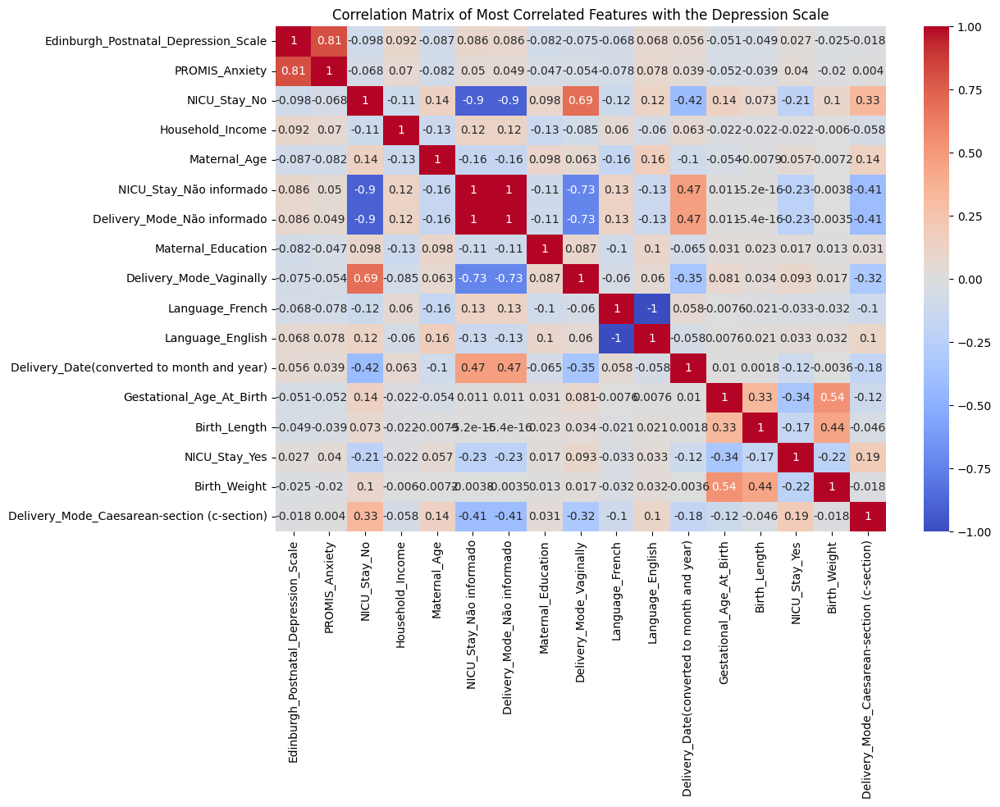

In [ ]:
#Clonando o dataset
data = database_completo_processado.copy()

#Gerando a correlação entre features e Depression State
correlation_with_target = data.corr()['Edinburgh_Postnatal_Depression_Scale'].abs().sort_values(ascending=False)

#Filtrando as features
top_features = correlation_with_target[correlation_with_target > 0.010].index
data_subset = data[top_features]

correlation_matrix = data_subset.corr()

#Plotando
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Most Correlated Features with the Depression Scale')
plt.show()

## Processamento dos Dados

In [ ]:
#Renomeando a variável para facilitar a utilização
drp = database_reduzido_processado
drp

drp.to_csv('drp.csv', index = False)

In [ ]:
#Renomeando a variável para facilitar a utilização
dcp = database_completo_processado
dcp

dcp.to_csv('dcp.csv', index = False)

In [ ]:
#Transformando os datasets em array
X1 = np.array(drp) #Dataset processado
X2 = np.array(dcp) #Dataset bruto

In [ ]:
#Array referente ao Silhuette Score
total_score_alg_e = []

#Array referente ao Davies Bouldin Score
total_score_alg_p = []

#Laço contando o tempo e rodando 50 vezes cada algoritmo afim de selecionar melhor parametros de custerização
for n in range(50):
  inicio1 = time.time()
  km1 = KMeans(n_clusters=2+n, n_init=1).fit(X1)
  fim1 = time.time()
  tempo_de_execucao1 = fim1 - inicio1

  inicio2 = time.time()
  ac1 = AgglomerativeClustering(n_clusters=2+n).fit(X1)
  fim2 = time.time()
  tempo_de_execucao2 = fim2 - inicio2

  inicio3 = time.time()
  db1 = DBSCAN(eps=0.3+(n/5), min_samples=2).fit(X1)
  fim3 = time.time()
  tempo_de_execucao3 = fim3 - inicio3

  inicio4 = time.time()
  km2 = KMeans(n_clusters=2+n, n_init=1).fit(X2)
  fim4 = time.time()
  tempo_de_execucao4 = fim4 - inicio4

  inicio5 = time.time()
  ac2 = AgglomerativeClustering().fit(X2)
  fim5 = time.time()
  tempo_de_execucao5 = fim5 - inicio5

  inicio6 = time.time()
  db2 = DBSCAN(eps=0.3+(n/5), min_samples=2).fit(X2)
  fim6 = time.time()
  tempo_de_execucao6 = fim6 - inicio6

  #Aplicando as métricas para os algoritmos com a métrica da silhouette_score
  total_score_alg_e.append([2+n,tempo_de_execucao1,metrics.silhouette_score(X1,  km1.labels_, metric='euclidean', random_state = 74)])
  total_score_alg_e.append([2+n,tempo_de_execucao2,metrics.silhouette_score(X1,  ac1.labels_, metric='euclidean', random_state = 74)])
  total_score_alg_e.append([0.3+(n/5),tempo_de_execucao3,(metrics.silhouette_score(X1,  db1.labels_, metric='euclidean', random_state = 74))])
  total_score_alg_e.append([2+n,tempo_de_execucao4,metrics.silhouette_score(X2,  km2.labels_, metric='euclidean', random_state = 74)])
  total_score_alg_e.append([2+n,tempo_de_execucao5,metrics.silhouette_score(X2,  ac2.labels_, metric='euclidean', random_state = 74)])
  total_score_alg_e.append([0.3+(n/5),tempo_de_execucao6,(metrics.silhouette_score(X2,  db2.labels_, metric='euclidean', random_state = 74))])

  #Aplicando as métricas para os algoritmos com a métrica da davies_bouldin_score
  total_score_alg_p.append([2+n,tempo_de_execucao1,metrics.davies_bouldin_score(X1,  km1.labels_)])
  total_score_alg_p.append([2+n,tempo_de_execucao2,metrics.davies_bouldin_score(X1,  ac1.labels_)])
  total_score_alg_p.append([0.3+(n/5),tempo_de_execucao3,metrics.davies_bouldin_score(X1,  db1.labels_)])
  total_score_alg_p.append([2+n,tempo_de_execucao4,metrics.davies_bouldin_score(X2,  km2.labels_)])
  total_score_alg_p.append([2+n,tempo_de_execucao5,metrics.davies_bouldin_score(X2,  ac2.labels_)])
  total_score_alg_p.append([0.3+(n/5),tempo_de_execucao6,metrics.davies_bouldin_score(X2,  db2.labels_)])

In [ ]:
#Printando score do silhouette
total_score_alg_e

[[2, 0.14238452911376953, 0.37787978999490596],
 [2, 5.348577976226807, 0.369302483376661],
 [0.3, 0.13881254196166992, -0.35500334251417537],
 [2, 0.1378796100616455, 0.6264650493740492],
 [2, 6.929130792617798, 0.6127381580876381],
 [0.3, 0.3757352828979492, -0.5213616902143341],
 [3, 0.02576899528503418, 0.3460502778973616],
 [3, 5.659301519393921, 0.2791716307974691],
 [0.5, 0.1398015022277832, -0.3845994750703034],
 [3, 0.14023804664611816, 0.6619631788525455],
 [3, 6.448768377304077, 0.6127381580876381],
 [0.5, 0.6937627792358398, -0.5142190933407945],
 [4, 0.03087925910949707, 0.32018800607087816],
 [4, 6.757944345474243, 0.26309161466712155],
 [0.7, 0.14524173736572266, -0.4064437584470237],
 [4, 0.10220885276794434, 0.605826401143995],
 [4, 5.758165597915649, 0.6127381580876381],
 [0.7, 0.39731359481811523, -0.5110616024703055],
 [5, 0.13974213600158691, 0.2978427546781396],
 [5, 5.695868015289307, 0.2642749530446045],
 [0.8999999999999999, 0.23671936988830566, -0.414141739425

In [ ]:
#Printando score do Davies Boudin
total_score_alg_p

[[2, 0.14238452911376953, 0.9572445727083299],
 [2, 5.348577976226807, 0.9773567290191628],
 [0.3, 0.13881254196166992, 8.01329834523432],
 [2, 0.1378796100616455, 0.6327841632087152],
 [2, 6.929130792617798, 0.6597247590303813],
 [0.3, 0.3757352828979492, 45.39819138434538],
 [3, 0.02576899528503418, 1.0021068968169908],
 [3, 5.659301519393921, 1.119385268470517],
 [0.5, 0.1398015022277832, 7.854758161540735],
 [3, 0.14023804664611816, 0.5101913625519604],
 [3, 6.448768377304077, 0.6597247590303813],
 [0.5, 0.6937627792358398, 45.05855922317789],
 [4, 0.03087925910949707, 1.1813411704777241],
 [4, 6.757944345474243, 1.213940320073119],
 [0.7, 0.14524173736572266, 7.878830056802032],
 [4, 0.10220885276794434, 0.5598424269653298],
 [4, 5.758165597915649, 0.6597247590303813],
 [0.7, 0.39731359481811523, 45.56673055530471],
 [5, 0.13974213600158691, 1.1746627095741982],
 [5, 5.695868015289307, 1.2613811284753245],
 [0.8999999999999999, 0.23671936988830566, 7.8119312281390485],
 [5, 0.3974

In [ ]:
#Organizando o header das tabelas
myTable1 = PrettyTable(["Algoritmo", "Métrica", "Database", "N de Clusters", "Tempo de Execução", "Score"])
myTable2 = PrettyTable(["Algoritmo", "Métrica", "Database", "N de Clusters", "Tempo de Execução", "Score"])
myTable3 = PrettyTable(["Algoritmo", "Métrica", "Database", "N de Clusters", "Tempo de Execução", "Score"])
myTable4 = PrettyTable(["Algoritmo", "Métrica", "Database", "N de Clusters", "Tempo de Execução", "Score"])
myTable5 = PrettyTable(["Algoritmo", "Métrica", "Database", "N de Clusters", "Tempo de Execução", "Score"])
myTable6 = PrettyTable(["Algoritmo", "Métrica", "Database", "N de Clusters", "Tempo de Execução", "Score"])

cont = 0 #Contador Auxiliar

#Imprimindo dados do score organizadamente nas tabelas
for i in range(300):
  if cont == 6:
    cont = 0
  match cont:
    case 0:
      myTable1.add_row(["K-means", "Silhouette Score", "Processado", total_score_alg_e[i][0],"{:.2f}s".format(total_score_alg_e[i][1]),"{:.2f}%".format(total_score_alg_e[i][2]*100)])
      myTable1.add_row(["K-means", "Davies Bouldin Score", "Processado", total_score_alg_p[i][0],"{:.2f}s".format(total_score_alg_p[i][1]),"{:.2f}".format(total_score_alg_p[i][2])])
    case 1:
      myTable2.add_row(["Aglommerative Cluster", "Silhouette Score", "Processado", total_score_alg_e[i][0],"{:.2f}s".format(total_score_alg_e[i][1]),"{:.2f}%".format(total_score_alg_e[i][2]*100)])
      myTable2.add_row(["Aglommerative Cluster", "Davies Bouldin Score", "Processado", total_score_alg_p[i][0],"{:.2f}s".format(total_score_alg_p[i][1]),"{:.2f}".format(total_score_alg_p[i][2])])
    case 2:
      myTable3.add_row(["DBSCAN", "Silhouette Score", "Processado", total_score_alg_e[i][0],"{:.2f}s".format(total_score_alg_e[i][1]),"{:.2f}%".format(total_score_alg_e[i][2]*100)])
      myTable3.add_row(["DBSCAN", "Davies Bouldin Score", "Processado", total_score_alg_p[i][0],"{:.2f}s".format(total_score_alg_p[i][1]),"{:.2f}".format(total_score_alg_p[i][2])])
    case 3:
      myTable4.add_row(["K-means", "Silhouette Score", "Bruto", total_score_alg_e[i][0],"{:.2f}s".format(total_score_alg_e[i][1]),"{:.2f}%".format(total_score_alg_e[i][2]*100)])
      myTable4.add_row(["K-means", "Davies Bouldin Score", "Bruto", total_score_alg_p[i][0],"{:.2f}s".format(total_score_alg_p[i][1]),"{:.2f}".format(total_score_alg_p[i][2])])
    case 4:
      myTable5.add_row(["Aglommerative Cluster", "Silhouette Score", "Bruto", total_score_alg_e[i][0],"{:.2f}s".format(total_score_alg_e[i][1]),"{:.2f}%".format(total_score_alg_e[i][2]*100)])
      myTable5.add_row(["Aglommerative Cluster", "Davies Bouldin Score", "Bruto", total_score_alg_p[i][0],"{:.2f}s".format(total_score_alg_p[i][1]),"{:.2f}".format(total_score_alg_p[i][2])])
    case 5:
      myTable6.add_row(["DBSCAN", "Silhouette Score", "Bruto", total_score_alg_e[i][0],"{:.2f}s".format(total_score_alg_e[i][1]),"{:.2f}%".format(total_score_alg_e[i][2]*100)])
      myTable6.add_row(["DBSCAN", "Davies Bouldin Score", "Bruto", total_score_alg_p[i][0],"{:.2f}s".format(total_score_alg_p[i][1]),"{:.2f}".format(total_score_alg_p[i][2])])
  cont+=1

In [ ]:
#Tabela referente ao K-means
drp['kclass2'] = KMeans(n_clusters=2, n_init=1).fit(X1).labels_
print(myTable1) #K-means Processado - 2 Clusters é o melhor

+-----------+----------------------+------------+---------------+-------------------+--------+
| Algoritmo |       Métrica        |  Database  | N de Clusters | Tempo de Execução | Score  |
+-----------+----------------------+------------+---------------+-------------------+--------+
|  K-means  |   Silhouette Score   | Processado |       2       |       0.14s       | 37.79% |
|  K-means  | Davies Bouldin Score | Processado |       2       |       0.14s       |  0.96  |
|  K-means  |   Silhouette Score   | Processado |       3       |       0.03s       | 34.61% |
|  K-means  | Davies Bouldin Score | Processado |       3       |       0.03s       |  1.00  |
|  K-means  |   Silhouette Score   | Processado |       4       |       0.03s       | 32.02% |
|  K-means  | Davies Bouldin Score | Processado |       4       |       0.03s       |  1.18  |
|  K-means  |   Silhouette Score   | Processado |       5       |       0.14s       | 29.78% |
|  K-means  | Davies Bouldin Score | Processado | 

In [ ]:
#Tabela referente ao Aglommerative Cluster
drp['aclass'] = AgglomerativeClustering(n_clusters=2).fit(X1).labels_
print(myTable2)  #AC Processado - 2 Clusters é o melhor

+-----------------------+----------------------+------------+---------------+-------------------+--------+
|       Algoritmo       |       Métrica        |  Database  | N de Clusters | Tempo de Execução | Score  |
+-----------------------+----------------------+------------+---------------+-------------------+--------+
| Aglommerative Cluster |   Silhouette Score   | Processado |       2       |       5.35s       | 36.93% |
| Aglommerative Cluster | Davies Bouldin Score | Processado |       2       |       5.35s       |  0.98  |
| Aglommerative Cluster |   Silhouette Score   | Processado |       3       |       5.66s       | 27.92% |
| Aglommerative Cluster | Davies Bouldin Score | Processado |       3       |       5.66s       |  1.12  |
| Aglommerative Cluster |   Silhouette Score   | Processado |       4       |       6.76s       | 26.31% |
| Aglommerative Cluster | Davies Bouldin Score | Processado |       4       |       6.76s       |  1.21  |
| Aglommerative Cluster |   Silhouett

In [ ]:
#Tabela referente ao DBSCAN
drp['pclass'] = DBSCAN(eps=10.1, min_samples=2).fit(X1).labels_
print(myTable3)  #DBSCAN Processado - 10.1 Eps é o melhor

+-----------+----------------------+------------+--------------------+-------------------+---------+
| Algoritmo |       Métrica        |  Database  |   N de Clusters    | Tempo de Execução |  Score  |
+-----------+----------------------+------------+--------------------+-------------------+---------+
|   DBSCAN  |   Silhouette Score   | Processado |        0.3         |       0.14s       | -35.50% |
|   DBSCAN  | Davies Bouldin Score | Processado |        0.3         |       0.14s       |   8.01  |
|   DBSCAN  |   Silhouette Score   | Processado |        0.5         |       0.14s       | -38.46% |
|   DBSCAN  | Davies Bouldin Score | Processado |        0.5         |       0.14s       |   7.85  |
|   DBSCAN  |   Silhouette Score   | Processado |        0.7         |       0.15s       | -40.64% |
|   DBSCAN  | Davies Bouldin Score | Processado |        0.7         |       0.15s       |   7.88  |
|   DBSCAN  |   Silhouette Score   | Processado | 0.8999999999999999 |       0.24s       | 

In [ ]:
#Tabela referente ao K-means
dcp['kclass2'] = KMeans(n_clusters=2, n_init=1).fit(X2).labels_
print(myTable4)  #K-means Bruto - 2 Clusters é o melhor

+-----------+----------------------+----------+---------------+-------------------+--------+
| Algoritmo |       Métrica        | Database | N de Clusters | Tempo de Execução | Score  |
+-----------+----------------------+----------+---------------+-------------------+--------+
|  K-means  |   Silhouette Score   |  Bruto   |       2       |       0.14s       | 62.65% |
|  K-means  | Davies Bouldin Score |  Bruto   |       2       |       0.14s       |  0.63  |
|  K-means  |   Silhouette Score   |  Bruto   |       3       |       0.14s       | 66.20% |
|  K-means  | Davies Bouldin Score |  Bruto   |       3       |       0.14s       |  0.51  |
|  K-means  |   Silhouette Score   |  Bruto   |       4       |       0.10s       | 60.58% |
|  K-means  | Davies Bouldin Score |  Bruto   |       4       |       0.10s       |  0.56  |
|  K-means  |   Silhouette Score   |  Bruto   |       5       |       0.40s       | 62.88% |
|  K-means  | Davies Bouldin Score |  Bruto   |       5       |       

In [ ]:
#Tabela referente ao Aglommerative Cluster
dcp['aclass'] = AgglomerativeClustering(n_clusters=2).fit(X2).labels_
print(myTable5)  #AC Bruto - 3 Clusters é o melhor

+-----------------------+----------------------+----------+---------------+-------------------+--------+
|       Algoritmo       |       Métrica        | Database | N de Clusters | Tempo de Execução | Score  |
+-----------------------+----------------------+----------+---------------+-------------------+--------+
| Aglommerative Cluster |   Silhouette Score   |  Bruto   |       2       |       6.93s       | 61.27% |
| Aglommerative Cluster | Davies Bouldin Score |  Bruto   |       2       |       6.93s       |  0.66  |
| Aglommerative Cluster |   Silhouette Score   |  Bruto   |       3       |       6.45s       | 61.27% |
| Aglommerative Cluster | Davies Bouldin Score |  Bruto   |       3       |       6.45s       |  0.66  |
| Aglommerative Cluster |   Silhouette Score   |  Bruto   |       4       |       5.76s       | 61.27% |
| Aglommerative Cluster | Davies Bouldin Score |  Bruto   |       4       |       5.76s       |  0.66  |
| Aglommerative Cluster |   Silhouette Score   |  Bruto

In [ ]:
#Tabela referente ao DBSCAN
dcp['pclass'] = DBSCAN(eps=10.1, min_samples=2).fit(X2).labels_
print(myTable6)  #DBSCAN Bruto - 10.1 Clusters é o melhor

+-----------+----------------------+----------+--------------------+-------------------+---------+
| Algoritmo |       Métrica        | Database |   N de Clusters    | Tempo de Execução |  Score  |
+-----------+----------------------+----------+--------------------+-------------------+---------+
|   DBSCAN  |   Silhouette Score   |  Bruto   |        0.3         |       0.38s       | -52.14% |
|   DBSCAN  | Davies Bouldin Score |  Bruto   |        0.3         |       0.38s       |  45.40  |
|   DBSCAN  |   Silhouette Score   |  Bruto   |        0.5         |       0.69s       | -51.42% |
|   DBSCAN  | Davies Bouldin Score |  Bruto   |        0.5         |       0.69s       |  45.06  |
|   DBSCAN  |   Silhouette Score   |  Bruto   |        0.7         |       0.40s       | -51.11% |
|   DBSCAN  | Davies Bouldin Score |  Bruto   |        0.7         |       0.40s       |  45.57  |
|   DBSCAN  |   Silhouette Score   |  Bruto   | 0.8999999999999999 |       0.37s       | -50.94% |
|   DBSCAN

In [ ]:
drp['Household_Income'] = l[0]
drp['Maternal_Education'] = l[1]

dcp['Household_Income'] = l[0]
dcp['Maternal_Education'] = l[1]

<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Household_Income'>

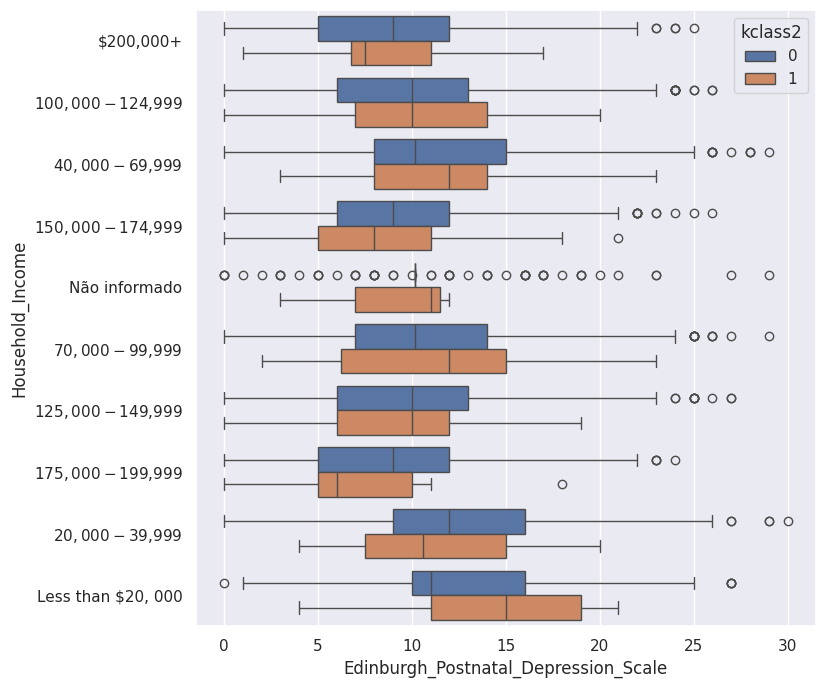

In [ ]:
#Box Plottando a Renda Familiar com Taxa de Depressão Pós Parto usando K-means com Dataset Processado
sns.set(rc={'figure.figsize':(8,8)})
sns.boxplot(data=drp, y="Household_Income", x="Edinburgh_Postnatal_Depression_Scale", hue="kclass2")

0                 $200,000+
1                 $200,000+
2        $100,000 -$124,999
3        $100,000 -$124,999
4           $40,000-$69,999
                ...        
10767    $100,000 -$124,999
10768    $125,000- $149,999
10769      $20,000- $39,999
10770      $20,000- $39,999
10771       $70,000-$99,999
Name: Household_Income, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Household_Income'>

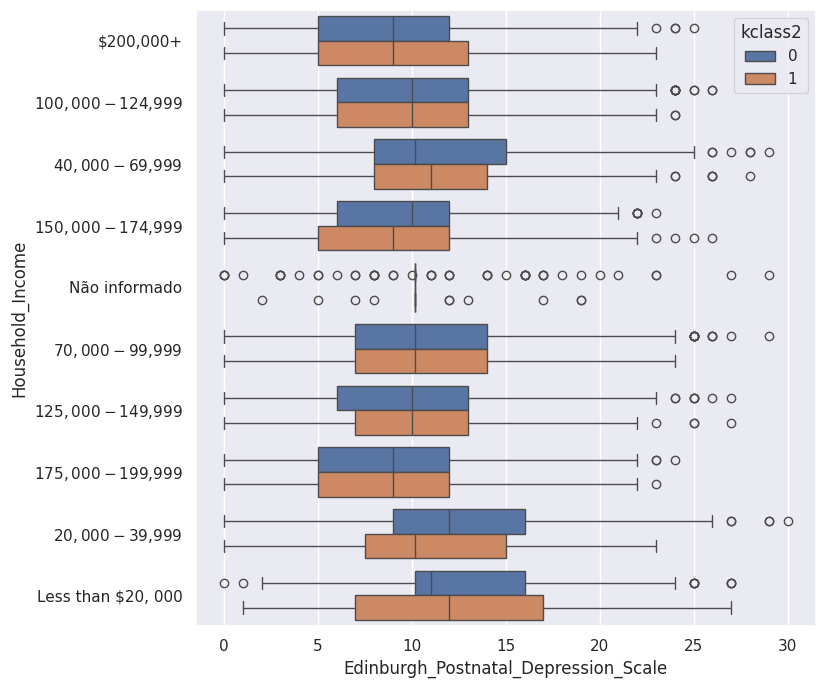

In [ ]:
#Box Plottando a Renda Familiar com Taxa de Depressão Pós Parto usando K-means com Dataset Bruto
print(l[0])
sns.boxplot(data=dcp, y="Household_Income", x="Edinburgh_Postnatal_Depression_Scale", hue="kclass2")

0                 $200,000+
1                 $200,000+
2        $100,000 -$124,999
3        $100,000 -$124,999
4           $40,000-$69,999
                ...        
10767    $100,000 -$124,999
10768    $125,000- $149,999
10769      $20,000- $39,999
10770      $20,000- $39,999
10771       $70,000-$99,999
Name: Household_Income, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Household_Income'>

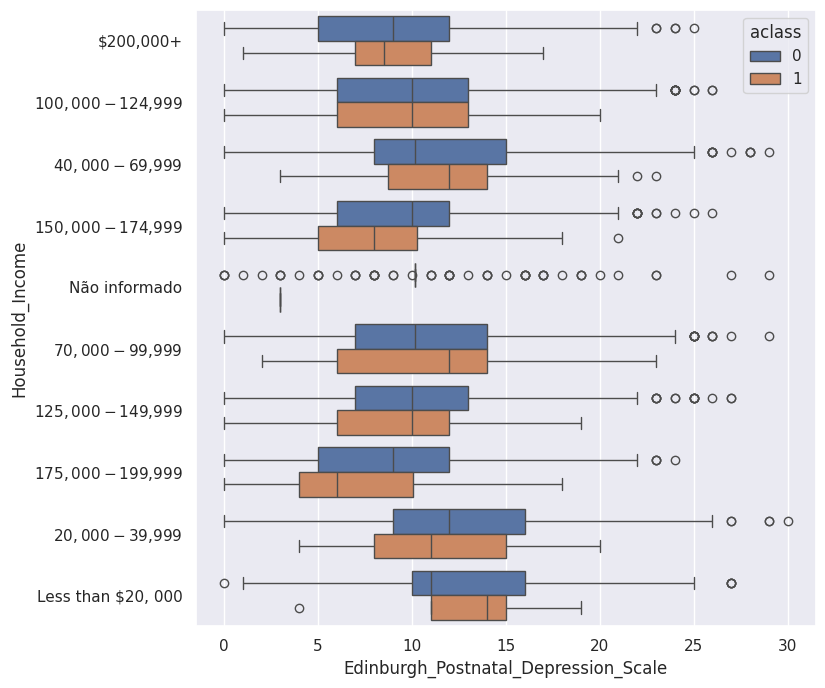

In [ ]:
#Box Plottando a Renda Familiar com Taxa de Depressão Pós Parto usando Agglomerative Clustering com Dataset Processado
print(l[0])
sns.boxplot(data=drp, y="Household_Income", x="Edinburgh_Postnatal_Depression_Scale", hue="aclass")

0                 $200,000+
1                 $200,000+
2        $100,000 -$124,999
3        $100,000 -$124,999
4           $40,000-$69,999
                ...        
10767    $100,000 -$124,999
10768    $125,000- $149,999
10769      $20,000- $39,999
10770      $20,000- $39,999
10771       $70,000-$99,999
Name: Household_Income, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Household_Income'>

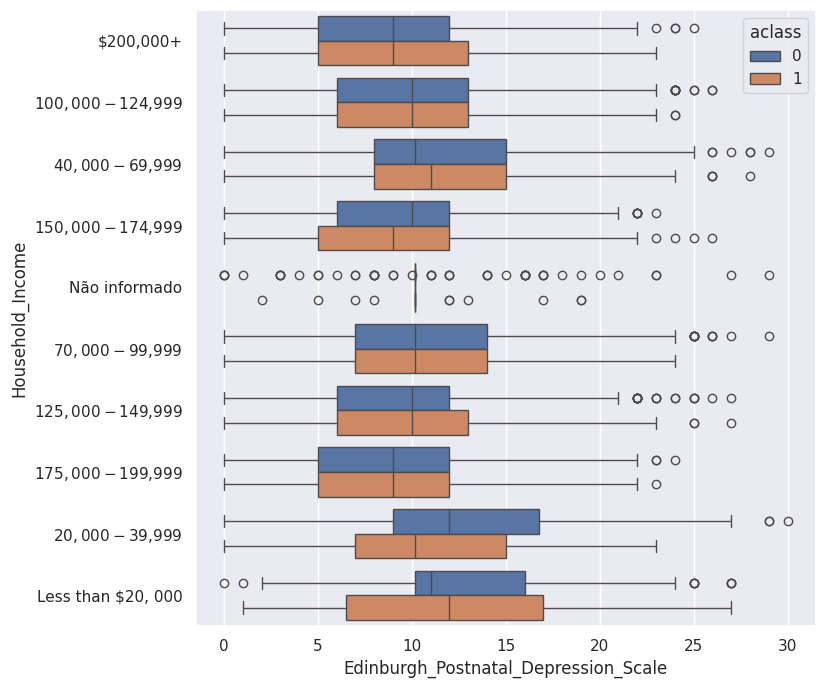

In [ ]:
#Box Plottando a Renda Familiar com Taxa de Depressão Pós Parto usando Agglomerative Clustering com Dataset Bruto
print(l[0])
sns.boxplot(data=dcp, y="Household_Income", x="Edinburgh_Postnatal_Depression_Scale", hue="aclass")

0              Masters degree
1        Undergraduate degree
2        Undergraduate degree
3              Masters degree
4        Undergraduate degree
                 ...         
10767    Undergraduate degree
10768    Undergraduate degree
10769    College/trade school
10770    College/trade school
10771          Masters degree
Name: Maternal_Education, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Maternal_Education'>

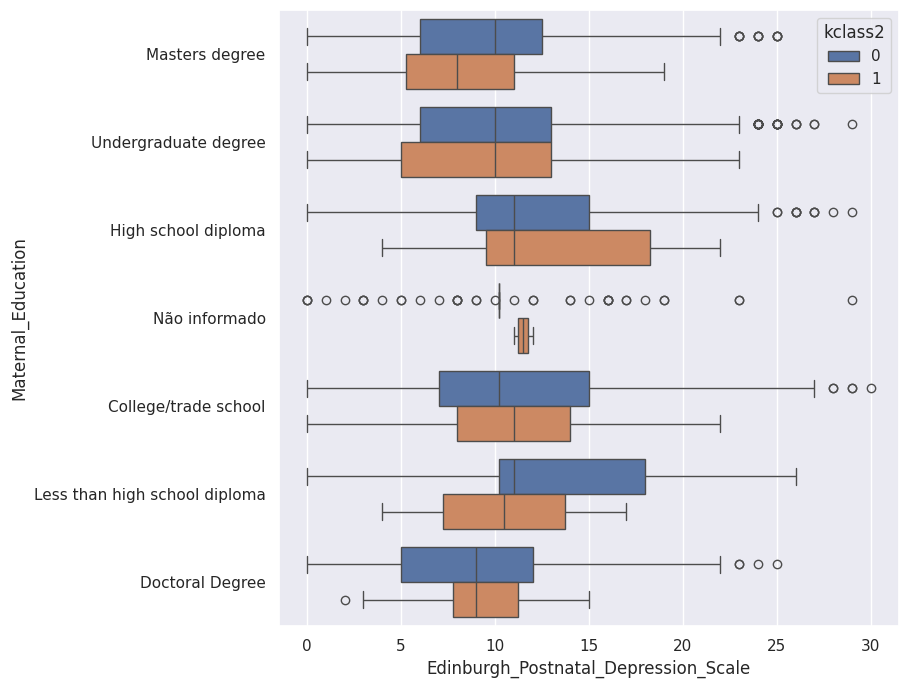

In [ ]:
#Box Plottando a Educação da mãe com Taxa de Depressão Pós Parto usando K-means com Dataset Processado
print(l[1])
sns.boxplot(data=drp, y="Maternal_Education", x="Edinburgh_Postnatal_Depression_Scale", hue="kclass2")

0              Masters degree
1        Undergraduate degree
2        Undergraduate degree
3              Masters degree
4        Undergraduate degree
                 ...         
10767    Undergraduate degree
10768    Undergraduate degree
10769    College/trade school
10770    College/trade school
10771          Masters degree
Name: Maternal_Education, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Maternal_Education'>

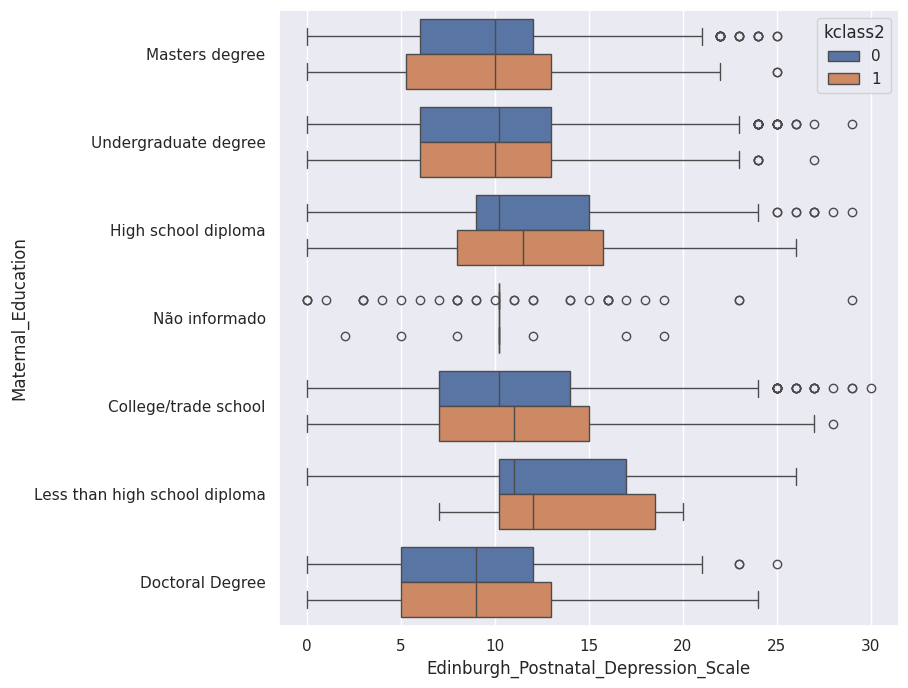

In [ ]:
#Box Plottando a Educação da mãe com Taxa de Depressão Pós Parto usando K-means com Dataset Bruto
print(l[1])
sns.boxplot(data=dcp, y="Maternal_Education", x="Edinburgh_Postnatal_Depression_Scale", hue="kclass2")

0              Masters degree
1        Undergraduate degree
2        Undergraduate degree
3              Masters degree
4        Undergraduate degree
                 ...         
10767    Undergraduate degree
10768    Undergraduate degree
10769    College/trade school
10770    College/trade school
10771          Masters degree
Name: Maternal_Education, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Maternal_Education'>

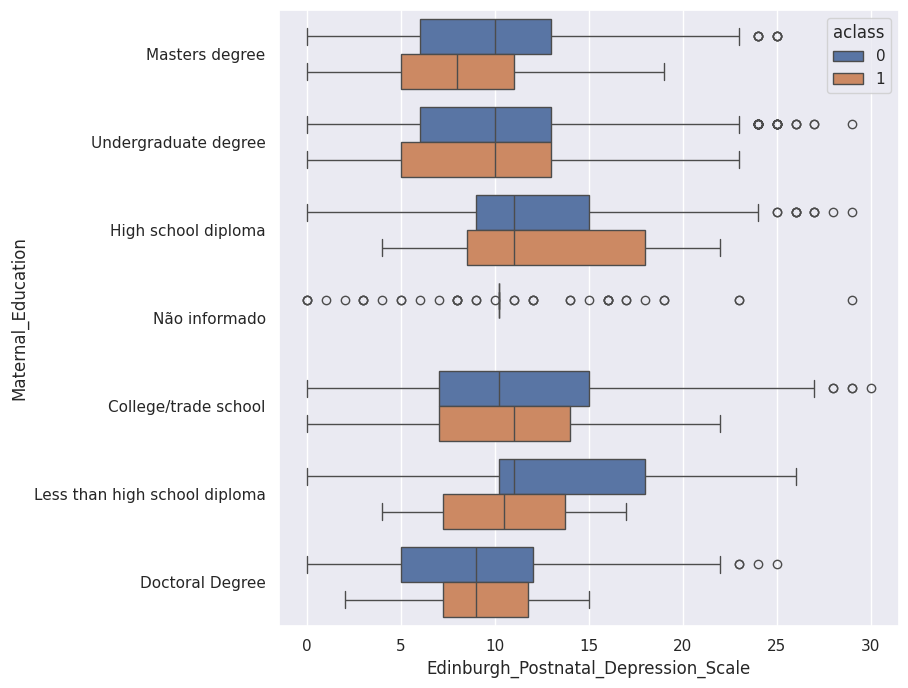

In [ ]:
#Box Plottando a Educação da mãe com Taxa de Depressão Pós Parto usando Agglomerative Clustering com Dataset Processado
print(l[1])
sns.boxplot(data=drp, y="Maternal_Education", x="Edinburgh_Postnatal_Depression_Scale", hue="aclass")

0              Masters degree
1        Undergraduate degree
2        Undergraduate degree
3              Masters degree
4        Undergraduate degree
                 ...         
10767    Undergraduate degree
10768    Undergraduate degree
10769    College/trade school
10770    College/trade school
10771          Masters degree
Name: Maternal_Education, Length: 10772, dtype: object


<Axes: xlabel='Edinburgh_Postnatal_Depression_Scale', ylabel='Maternal_Education'>

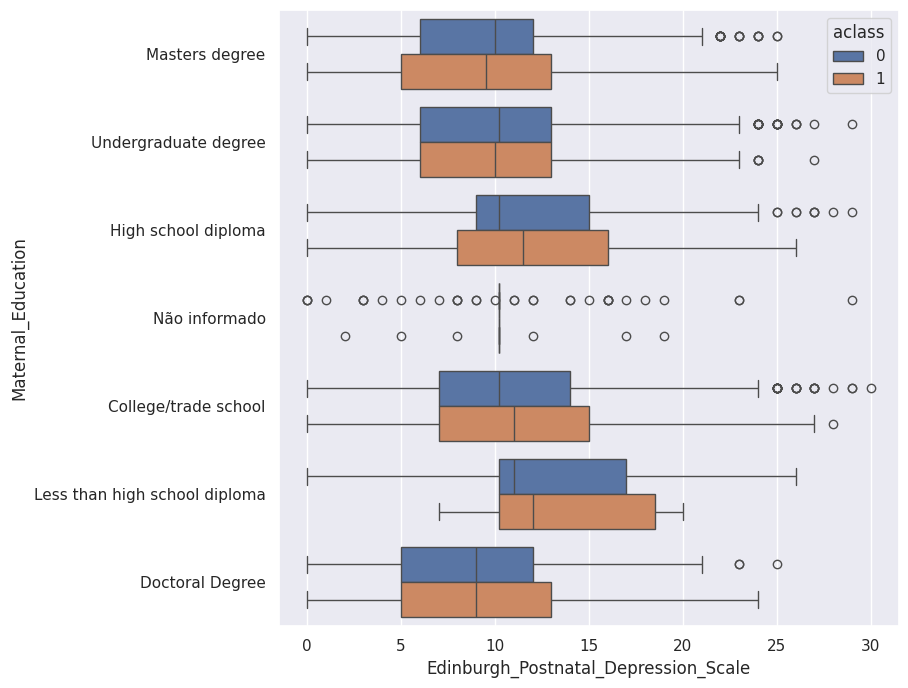

In [ ]:
#Box Plottando a Educação da mãe com Taxa de Depressão Pós Parto usando Agglomerative Clustering com Dataset Bruto
print(l[1])
sns.boxplot(data=dcp, x="Edinburgh_Postnatal_Depression_Scale", y="Maternal_Education", hue="aclass")

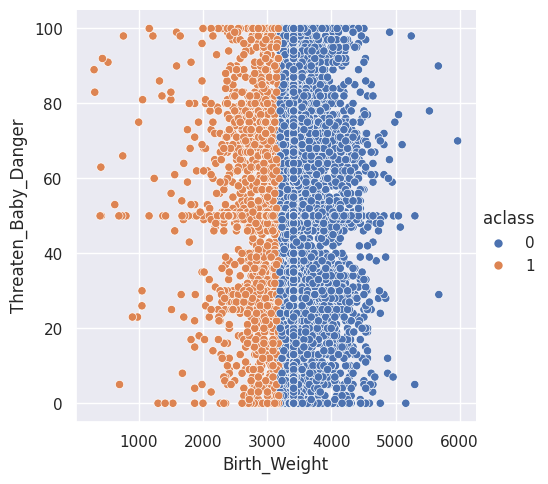

In [ ]:
sns.relplot(data=dcp, x="Birth_Weight", y="Threaten_Baby_Danger", hue="aclass")

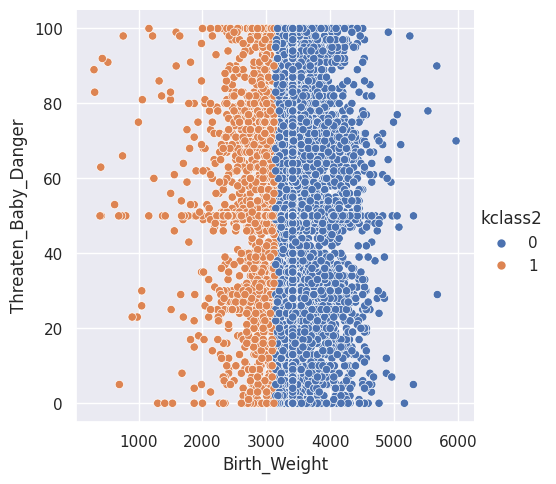

In [ ]:
sns.relplot(data=dcp, x="Birth_Weight", y="Threaten_Baby_Danger", hue="kclass2")

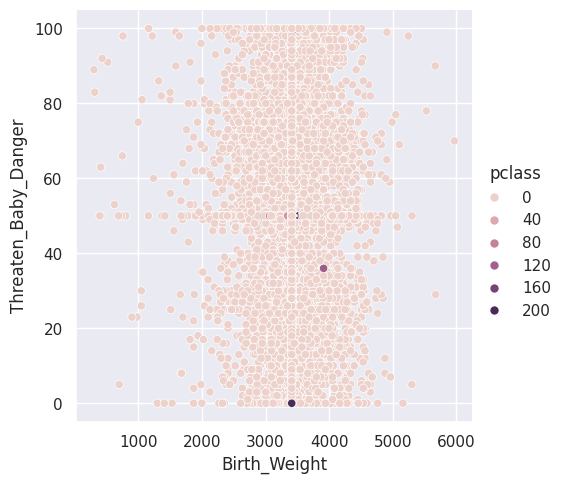

In [ ]:
sns.relplot(data=dcp, x="Birth_Weight", y="Threaten_Baby_Danger", hue="pclass")

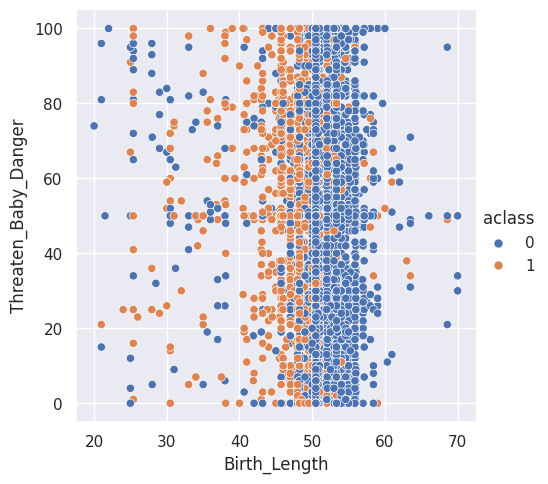

In [ ]:
sns.relplot(data=dcp, x="Birth_Length", y="Threaten_Baby_Danger", hue="aclass")

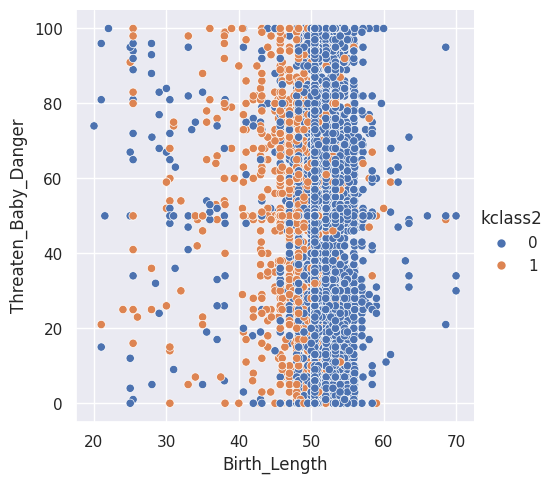

In [ ]:
sns.relplot(data=dcp, x="Birth_Length", y="Threaten_Baby_Danger", hue="kclass2")

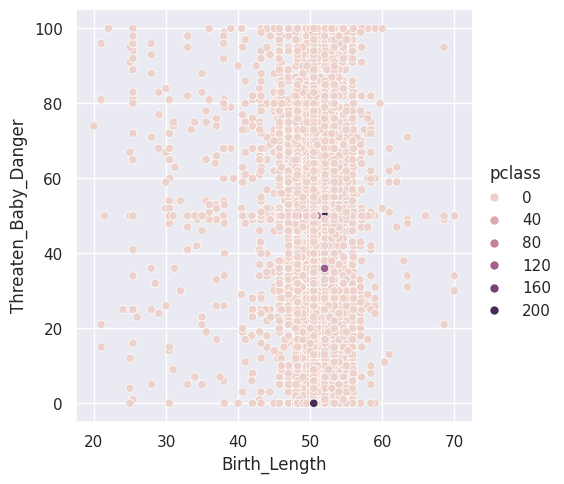

In [ ]:
sns.relplot(data=dcp, x="Birth_Length", y="Threaten_Baby_Danger", hue="pclass")

In [ ]:
drp

,Maternal_Age,Household_Income,Maternal_Education,Edinburgh_Postnatal_Depression_Scale,Threaten_Life,Threaten_Baby_Danger,Threaten_Baby_Harm,Language_English,Language_French,kclass2,aclass,pclass
0,38.3,"$200,000+",Masters degree,9.000000,2,3,27,1,0,0,0,-1
1,34.6,"$200,000+",Undergraduate degree,4.000000,2,33,92,1,0,0,0,-1
2,34.3,"$100,000 -$124,999",Undergraduate degree,10.194832,42,50,62,0,1,0,0,0
3,28.8,"$100,000 -$124,999",Masters degree,9.000000,53,67,54,0,1,0,0,-1
4,36.5,"$40,000-$69,999",Undergraduate degree,14.000000,23,32,71,1,0,0,0,-1
...,...,...,...,...,...,...,...,...,...,...,...,...
10767,38.3,"$100,000 -$124,999",Undergraduate degree,10.000000,54,62,74,1,0,0,0,-1
10768,29.9,"$125,000- $149,999",Undergraduate degree,10.194832,42,50,62,1,0,0,0,0
10769,27.7,"$20,000- $39,999",College/trade school,4.000000,21,93,76,0,1,0,0,-1
10770,23.0,"$20,000- $39,999",College/trade school,12.000000,65,94,94,1,0,0,0,-1


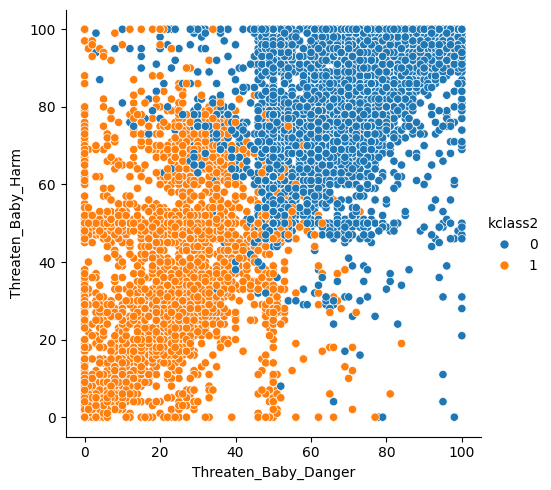

In [ ]:
sns.relplot(data=drp, y="Threaten_Baby_Harm", x="Threaten_Baby_Danger", hue="kclass2")

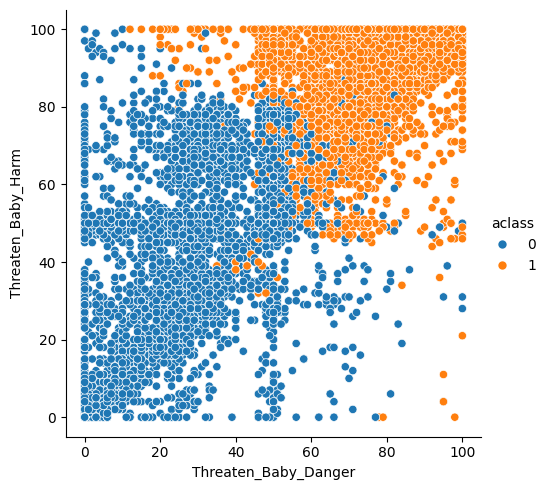

In [ ]:
sns.relplot(data=drp, y="Threaten_Baby_Harm", x="Threaten_Baby_Danger", hue="aclass")

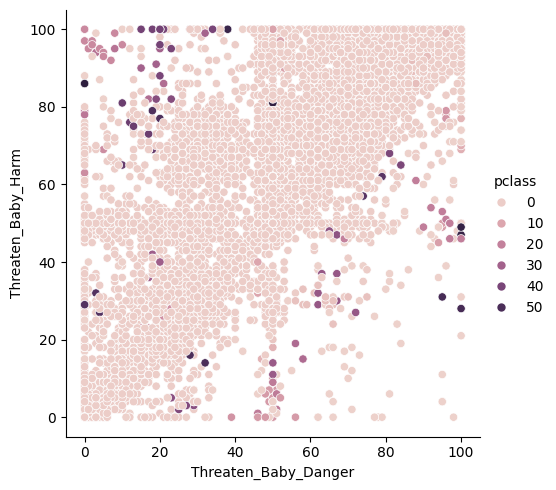

In [ ]:
sns.relplot(data=drp, y="Threaten_Baby_Harm", x="Threaten_Baby_Danger", hue="pclass")

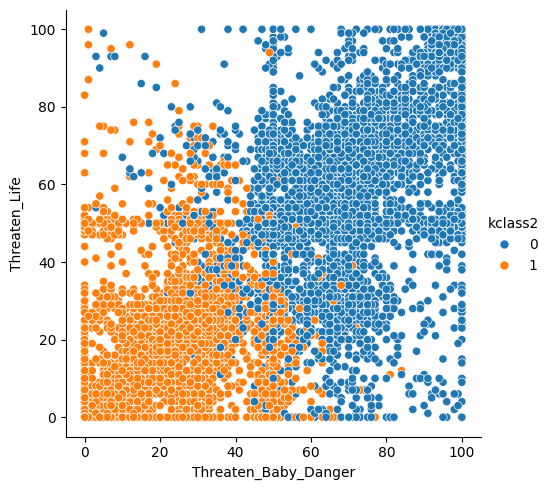

In [ ]:
sns.relplot(data=drp, y="Threaten_Life", x="Threaten_Baby_Danger", hue="kclass2")

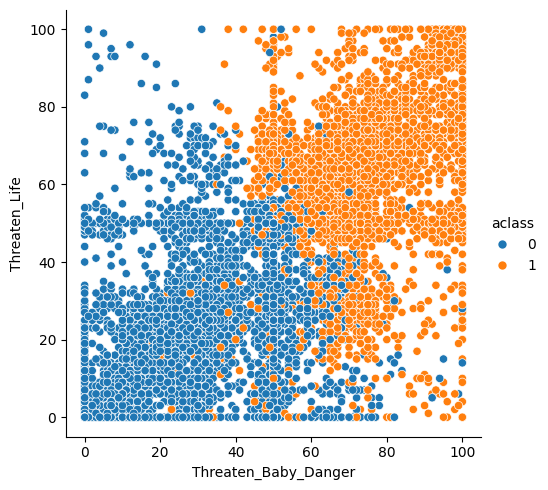

In [ ]:
sns.relplot(data=drp, y="Threaten_Life", x="Threaten_Baby_Danger", hue="aclass")

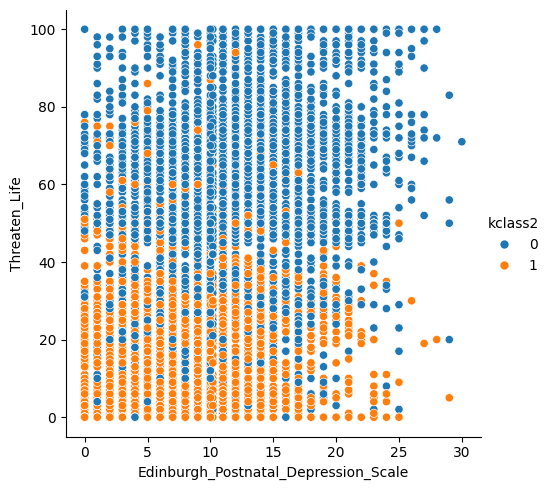

In [ ]:
sns.relplot(data=drp, y="Threaten_Life", x="Edinburgh_Postnatal_Depression_Scale", hue="kclass2")

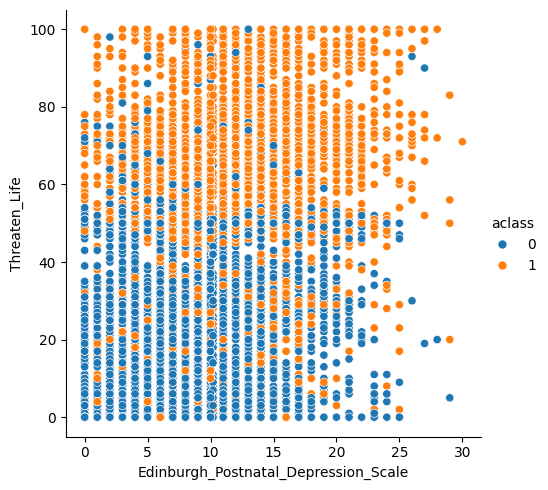

In [ ]:
sns.relplot(data=drp, y="Threaten_Life", x="Edinburgh_Postnatal_Depression_Scale", hue="aclass")

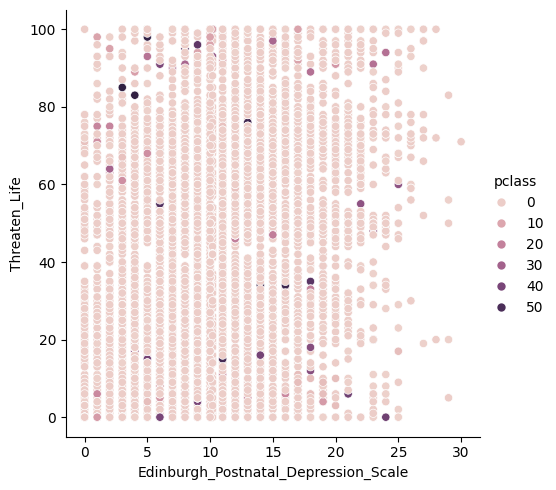

In [ ]:
sns.relplot(data=drp, y="Threaten_Life", x="Edinburgh_Postnatal_Depression_Scale", hue="pclass")

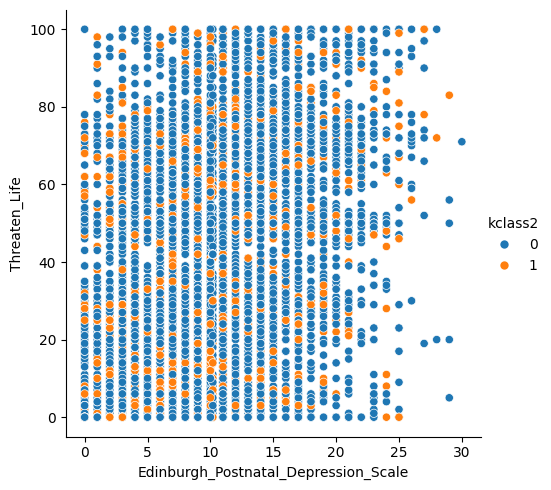

In [ ]:
sns.relplot(data=dcp, y="Threaten_Life", x="Edinburgh_Postnatal_Depression_Scale", hue="kclass2")

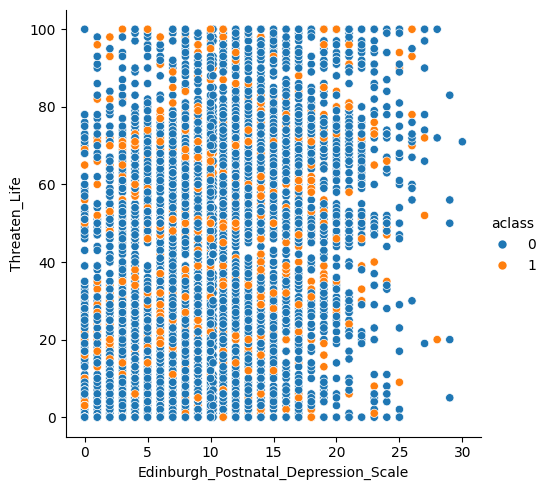

In [ ]:
sns.relplot(data=dcp, y="Threaten_Life", x="Edinburgh_Postnatal_Depression_Scale", hue="aclass")

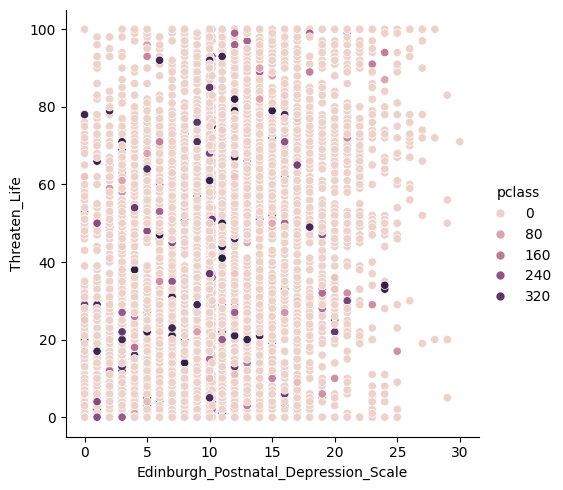

In [ ]:
sns.relplot(data=dcp, y="Threaten_Life", x="Edinburgh_Postnatal_Depression_Scale", hue="pclass")

In [ ]:
#Organizando colunas que serão Plotadas
drp_plot = drp.drop('Language_French' ,axis = 1);
drp_plot = drp_plot.drop('Language_English' ,axis = 1);
drp_plot = drp_plot.drop('Maternal_Education' ,axis = 1);

dcp_plot = dcp.drop('Maternal_Education' ,axis = 1);
dcp_plot = dcp_plot.drop('Delivery_Mode_Caesarean-section (c-section)' ,axis = 1);
dcp_plot = dcp_plot.drop('Delivery_Mode_Não informado' ,axis = 1);
dcp_plot = dcp_plot.drop('Delivery_Mode_Vaginally' ,axis = 1);
dcp_plot = dcp_plot.drop('Language_French' ,axis = 1);
dcp_plot = dcp_plot.drop('Language_English' ,axis = 1);
dcp_plot = dcp_plot.drop('Birth_Length' ,axis = 1);
dcp_plot = dcp_plot.drop('Birth_Weight' ,axis = 1);
dcp_plot = dcp_plot.drop('NICU_Stay_No' ,axis = 1);
dcp_plot = dcp_plot.drop('NICU_Stay_Não informado' ,axis = 1);
dcp_plot = dcp_plot.drop('NICU_Stay_Yes' ,axis = 1);
dcp_plot = dcp_plot.drop('Delivery_Date(converted to month and year)' ,axis = 1);
dcp_plot = dcp_plot.drop('Gestational_Age_At_Birth' ,axis = 1);
dcp_plot = dcp_plot.drop('PROMIS_Anxiety' ,axis = 1);

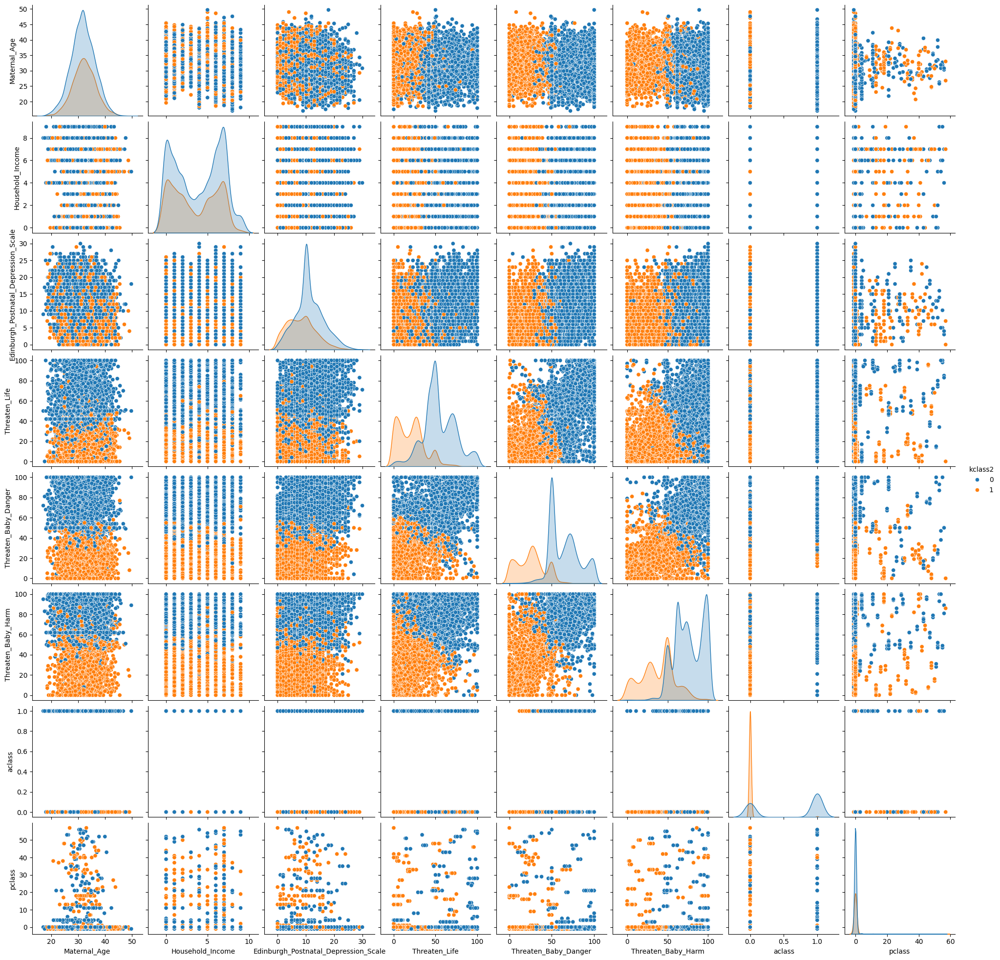

In [ ]:
sns.pairplot(data=drp_plot, hue="kclass2")

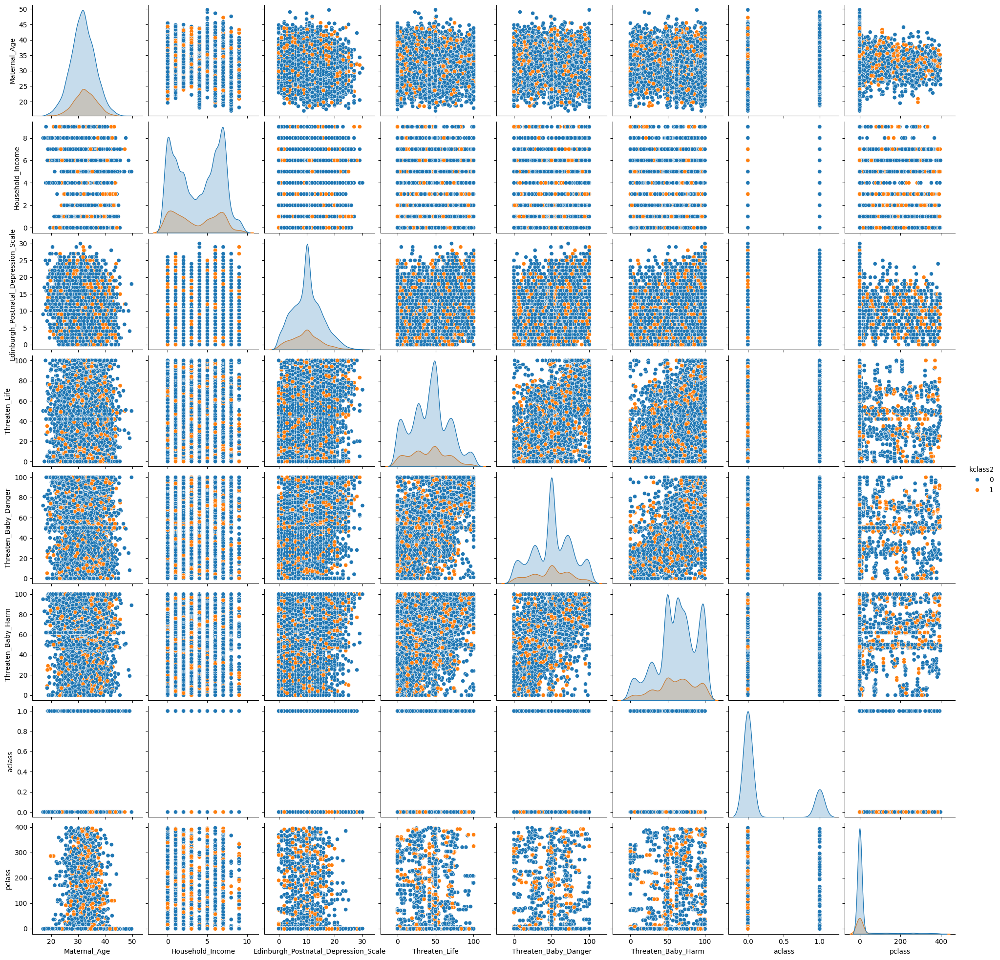

In [ ]:
sns.pairplot(data=dcp_plot, hue="kclass2")

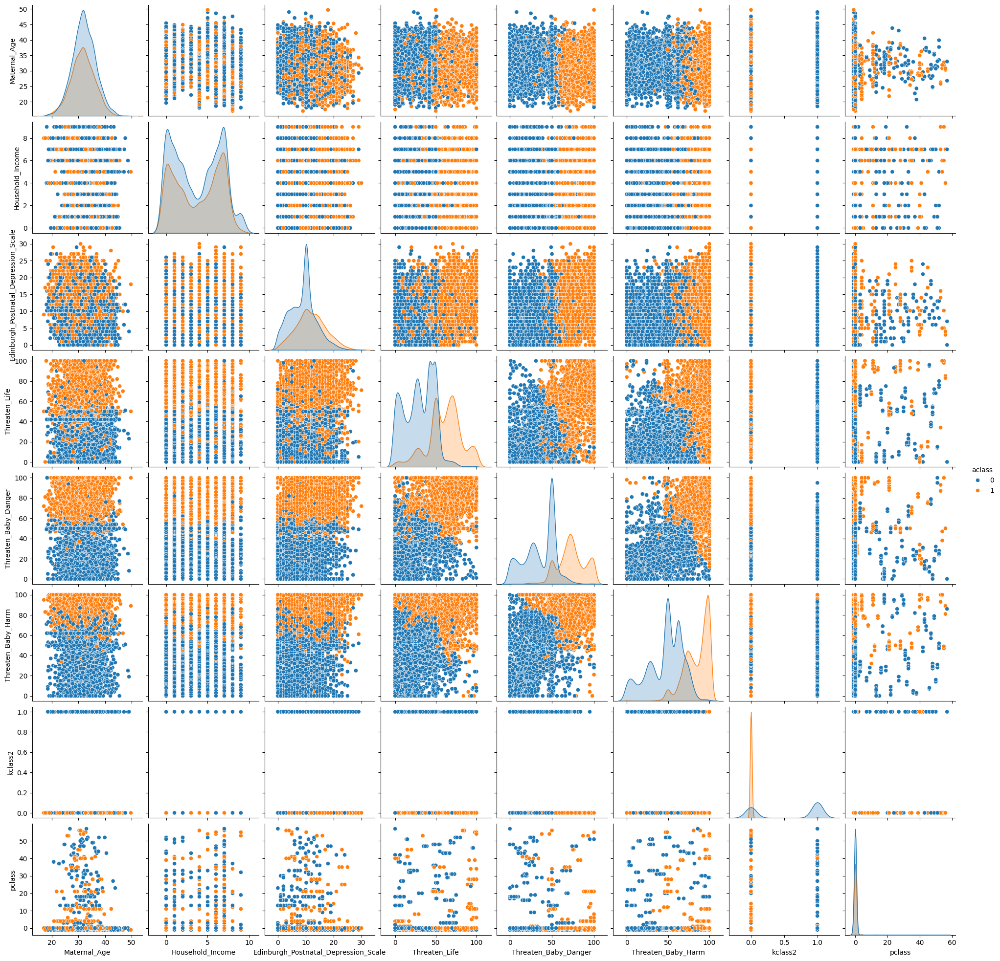

In [ ]:
sns.pairplot(data=drp_plot, hue="aclass")

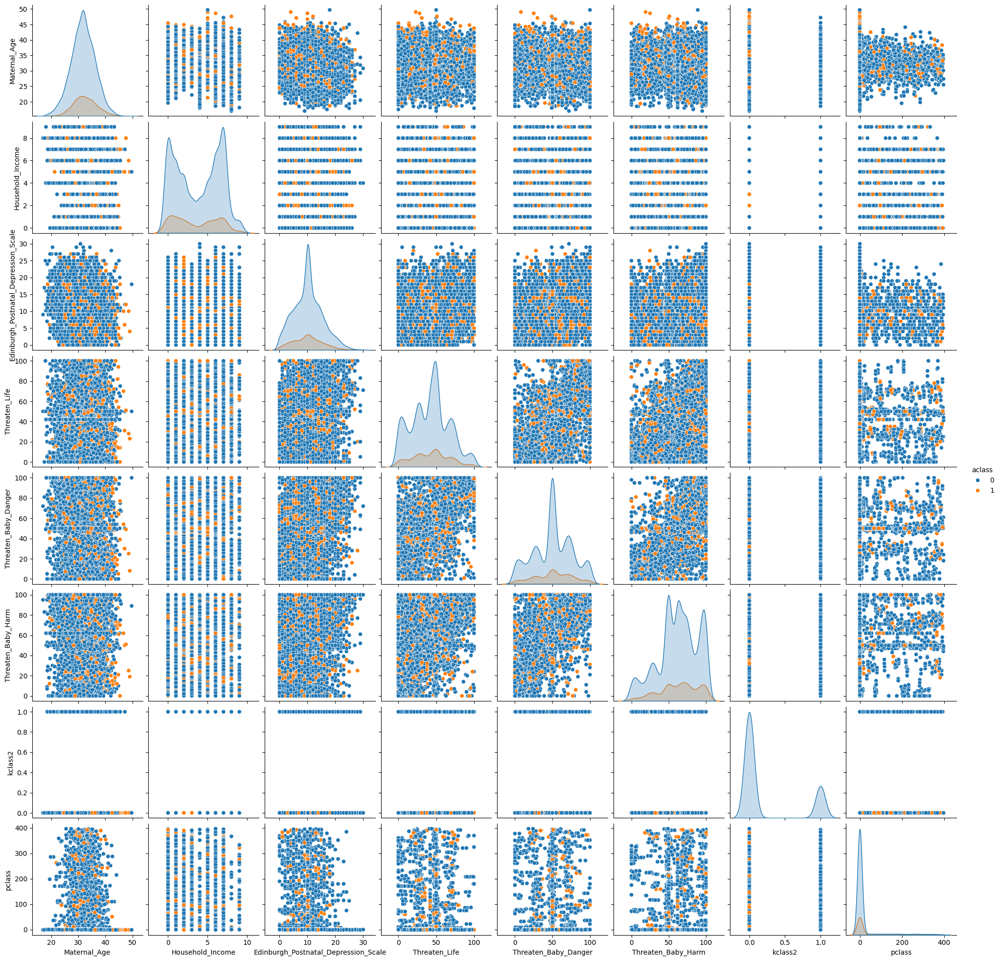

In [ ]:
sns.pairplot(data=dcp_plot, hue="aclass")

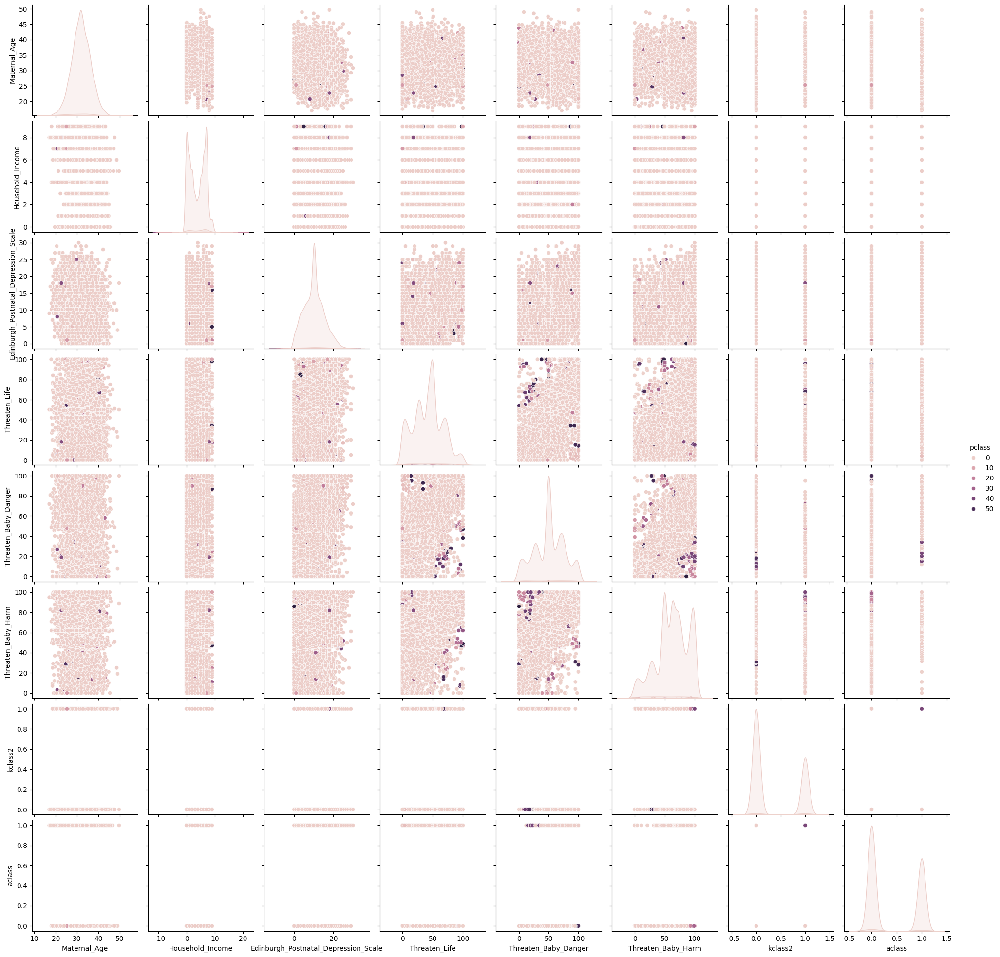

In [ ]:
sns.pairplot(data=drp_plot, hue="pclass")

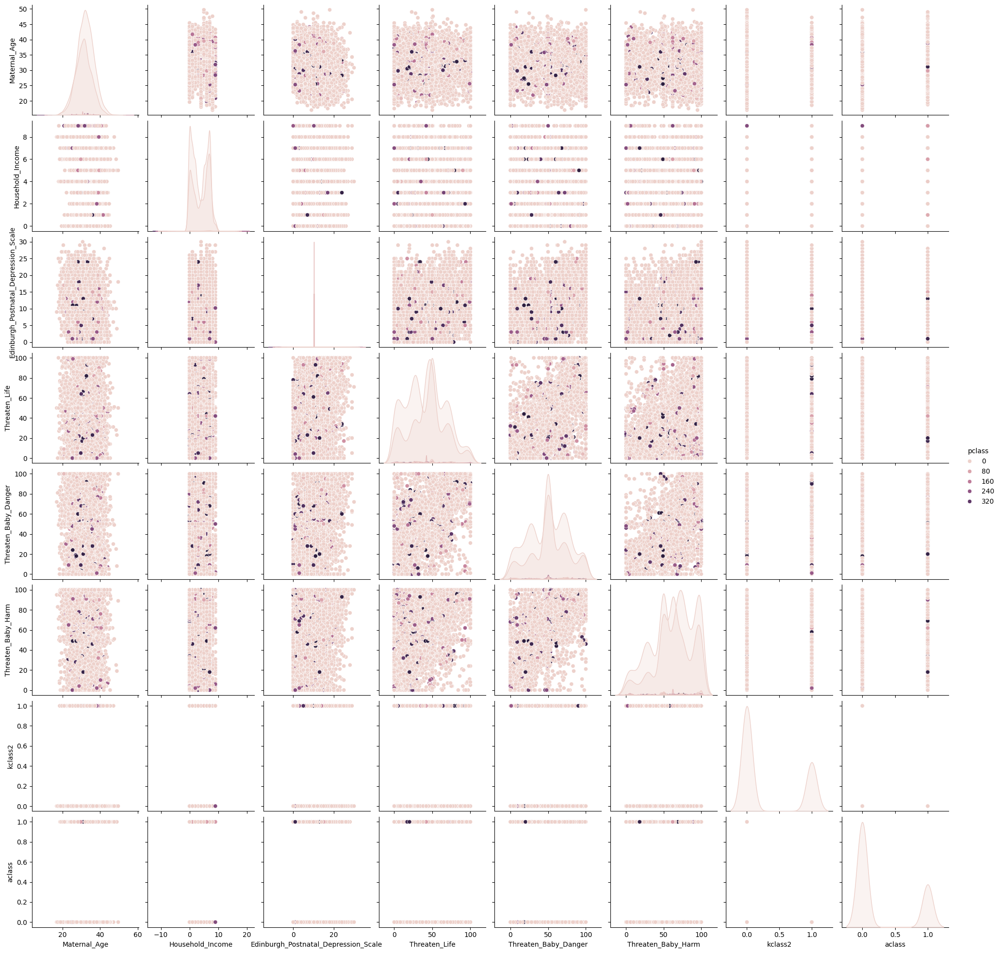

In [ ]:
sns.pairplot(data=dcp_plot, hue="pclass")